**HOME CREDIT PROBLEM**

In this discussion, we will discuss about Home Credit problem which is to classify people who will likely to repay or not repay the loan. Home Credit is a finance company that provides financing services for customers who shop online and offline. It provides financing for their customers so that they can fulfill their financial needs. Credit datasets consist of some datasets that correlate with each other.There are 2 services that are offered by this company. In this discussion, we will use only one dataset which is application train.


In [ ]:
#!unzip '/content/drive/MyDrive/home-credit-default-risk.zip' -d '/content/yuhu'

**Import Dataset**


In [ ]:
import pandas as pd
from sklearn.preprocessing import LabelEncoder
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objs as go
import plotly.offline as py

df_app = pd.read_csv('/content/yuhu/application_train.csv')
df_app
df_app_test = pd.read_csv('/content/yuhu/application_test.csv')

There are 3M applicants with 122 features. This is a huge dataset

**Investigating the dataset**

In [ ]:
df_app.TARGET.value_counts()/len(df_app)

0    0.919271
1    0.080729
Name: TARGET, dtype: float64

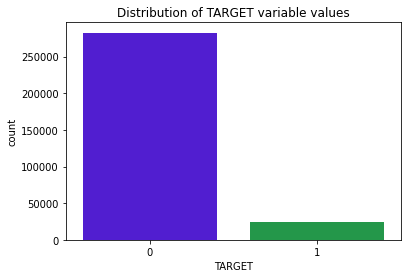

In [ ]:
plt.title('Distribution of TARGET variable values')
sns.countplot(x=df_app.TARGET,palette = ['#40E','#1A4'])

The training dataset only comprises of binary target value :

0 indicates the people who are likely to repay the loan

1 indicates the people who are likely to be defaulters

This data seems highly imbalanced. The number of people who are likely to repay the loan is very much higher than those who are not.

In [ ]:
len(df_app.columns)

122

There are 122 feature variables, next we must check the null value across all variables, thus we can drop variables whose the numbers of null values are high

In [ ]:
df_app.isnull().sum()/len(df_app)*100

SK_ID_CURR                     0.000000
TARGET                         0.000000
NAME_CONTRACT_TYPE             0.000000
CODE_GENDER                    0.000000
FLAG_OWN_CAR                   0.000000
                                ...    
AMT_REQ_CREDIT_BUREAU_DAY     13.501631
AMT_REQ_CREDIT_BUREAU_WEEK    13.501631
AMT_REQ_CREDIT_BUREAU_MON     13.501631
AMT_REQ_CREDIT_BUREAU_QRT     13.501631
AMT_REQ_CREDIT_BUREAU_YEAR    13.501631
Length: 122, dtype: float64

In [ ]:
miss_val = pd.DataFrame(df_app.isnull().sum()/len(df_app)*100)

In [ ]:
miss_val.reset_index(inplace = True)

In [ ]:
miss_val

,index,0
0,SK_ID_CURR,0.000000
1,TARGET,0.000000
2,NAME_CONTRACT_TYPE,0.000000
3,CODE_GENDER,0.000000
4,FLAG_OWN_CAR,0.000000
...,...,...
117,AMT_REQ_CREDIT_BUREAU_DAY,13.501631
118,AMT_REQ_CREDIT_BUREAU_WEEK,13.501631
119,AMT_REQ_CREDIT_BUREAU_MON,13.501631
120,AMT_REQ_CREDIT_BUREAU_QRT,13.501631


In [ ]:
miss_val.rename({'index':'features',0 : 'percentage'}, axis = 1, inplace = True)

In [ ]:
miss_val.sort_values(by = 'percentage', ascending = False).head(50)

,features,percentage
76,COMMONAREA_MEDI,69.872297
48,COMMONAREA_AVG,69.872297
62,COMMONAREA_MODE,69.872297
70,NONLIVINGAPARTMENTS_MODE,69.432963
56,NONLIVINGAPARTMENTS_AVG,69.432963
84,NONLIVINGAPARTMENTS_MEDI,69.432963
86,FONDKAPREMONT_MODE,68.386172
68,LIVINGAPARTMENTS_MODE,68.354953
54,LIVINGAPARTMENTS_AVG,68.354953
82,LIVINGAPARTMENTS_MEDI,68.354953


The are many variables which have high number of missing values. The maximum amount of missing values are nearly 70%. Thus, it is very impractical to keep these variables, therefore dropping these features will save our machine learning from dimentionality reduction and to keep our machine learning model simple and interpretable

In [ ]:
df_app.select_dtypes('object').apply(pd.Series.nunique, axis = 0)

NAME_CONTRACT_TYPE             2
CODE_GENDER                    3
FLAG_OWN_CAR                   2
FLAG_OWN_REALTY                2
NAME_TYPE_SUITE                7
NAME_INCOME_TYPE               8
NAME_EDUCATION_TYPE            5
NAME_FAMILY_STATUS             6
NAME_HOUSING_TYPE              6
OCCUPATION_TYPE               18
WEEKDAY_APPR_PROCESS_START     7
ORGANIZATION_TYPE             58
FONDKAPREMONT_MODE             4
HOUSETYPE_MODE                 3
WALLSMATERIAL_MODE             7
EMERGENCYSTATE_MODE            2
dtype: int64

**ENCODING CATEGORICAL VARIABLE**

There are categorical variables (typed with object) having various number of unique value in it. The highest value of it is 58 unique values which is ORGANIZATION_TYPE variable, and the fewest value is 2, which is binary value for NAME_CONTRACT_TYPE, FLAG_OWN_CAR, FLAG_OWN_REALTY, EMERGENCYSTATE_MODE

In [ ]:
# Create a label encoder object
le = LabelEncoder()
le_count = 0

# Iterate through the columns
for col in df_app:
    if df_app[col].dtype == 'object':
        # If 2 or fewer unique categories
        if len(list(df_app[col].unique())) <= 2:
            # Train on the training data
            le.fit(df_app[col])
            # Transform both training and testing data
            df_app[col] = le.transform(df_app[col])
            # df_app[col] = le.transform(df_app[col])
            
            # Keep track of how many columns were label encoded
            le_count += 1
print('%d columns were label encoded.' % le_count)        
le = LabelEncoder()
le_count = 0

# Iterate through the columns
for col in df_app_test:
    if df_app_test[col].dtype == 'object':
        # If 2 or fewer unique categories
        if len(list(df_app_test[col].unique())) <= 2:
            # Train on the training data
            le.fit(df_app_test[col])
            # Transform both training and testing data
            df_app_test[col] = le.transform(df_app_test[col])
            # df_app[col] = le.transform(df_app[col])
            
            # Keep track of how many columns were label encoded
            le_count += 1
print('%d columns were label encoded.' % le_count)

3 columns were label encoded.
4 columns were label encoded.


Therefore, we need to encode these categorical values into numerical values.In this case, label encoder is favorable for binary categorical values. After doing this, we have 3 columns that have been turned into numerical values

In [ ]:
df_app['CODE_GENDER'].value_counts()

F      202448
M      105059
XNA         4
Name: CODE_GENDER, dtype: int64

In [ ]:
# This dataframe has 244 lines, but 4 distinct values for `day`
# df = px.data.tips()
fig = px.pie(df_app, names='CODE_GENDER', title = 'Pie Chart of Gender')
fig.show()

It can be seen that most borrowers are female and its number is almost as twice as the male's

In [ ]:
px.histogram(df_app, x='CODE_GENDER', title='Client Gender vs. Applicant Default Risk', color='TARGET',
            color_discrete_map = {0:'#39F', 1:'#FFA501'})

From the graph above, we can conclude that the number of borrowers dominated by people who are likely to pay the loan regardless the genders. Thus, we could say that gender is not a good predictor since both gender does not display different characteristics 

In [ ]:
px.histogram(df_app, 
             x='NAME_INCOME_TYPE', 
             title='Clients Income Type vs. Applicant Default Risk', 
             color='TARGET',
            color_discrete_map = {0:'#40E0D0', 1:'rgba(255, 0, 0, 0.6)'})

In [ ]:
fig = px.pie(df_app, values='TARGET', names='NAME_INCOME_TYPE', title='Income Type')
fig.show()

Clients Income Type is simply put an applicant's income type. There are 6 income types and the majority of them is working, and it can be seen that in all types, the percentage of those who are likely to pay the loan is much higher than those who are not. Thus, this feature is not a good predictor

In [ ]:
px.histogram(df_app, 
             x='NAME_TYPE_SUITE', 
             title='Who accompanied Client vs. Applicant Default Risk', 
             color='TARGET',
            color_discrete_map = {0:'#4FE0D6', 1:'rgba(122, 255, 123, 0.6)'})

The name of type of the suite is dominated by unaccompanied, and followed by family and spouse, partner. This feature does not show that "NAME_TYPE_SUITE" has evidence to become a critical feature to maintain. 

In [ ]:
temp = df_app["NAME_CONTRACT_TYPE"].value_counts()
fig = {
  "data": [
    {
      "values": temp.values,
      "labels": temp.index,
      "domain": {"x": [0, .48]},
      #"name": "Types of Loans",
      #"hoverinfo":"label+percent+name",
      "hole": .7,
      "type": "pie"
    },
    
    ],
  "layout": {
        "title":"Types of loan",
        "annotations": [
            {
                "font": {
                    "size": 20
                },
                "showarrow": False,
                "text": "Loan Types",
                "x": 0.17,
                "y": 0.5
            }
            
        ]
    }
}
py.iplot(fig, filename='donut')

There are two fundamental types of credit repayments: revolving credit and installment credit. Revolving credit allows borrowers to spend the borrowed money, repay it, and spend it again. The lender advances them a set credit limit that can be used all at once or in part.

In contrast, borrowers repay cash loans with scheduled, periodic payments. This type of credit involves the gradual reduction of principal and eventual full repayment, ending the credit cycle.

It can be seen majority of people (about 90%) made cash loan instead of revolving loan (only approximately 10%)


In [ ]:
temp1 = df_app["FLAG_OWN_CAR"].value_counts()
temp2 = df_app["FLAG_OWN_REALTY"].value_counts()

fig = {
  "data": [
    {
      "values": temp1.values,
      "labels": temp1.index,
      "domain": {"x": [0, .48]},
      "name": "Own Car",
      "hoverinfo":"label+percent+name",
      "hole": .6,
      "type": "pie"
    },
    {
      "values": temp2.values,
      "labels": temp2.index,
     
      "textposition":"inside",
      "domain": {"x": [.52, 1]},
      "name": "Own Reality",
      "hoverinfo":"label+percent+name",
      "hole": .6,
      "type": "pie"
    }],
  "layout": {
        "title":"Purpose of loan",
        "annotations": [
            {
                "font": {
                    "size": 20
                },
                "showarrow": False,
                "text" : "Own Car" ,             
                "x": 0.20,
                "y": 0.5
            },
            {
                "font": {
                    "size": 20
                },
                "showarrow": False,
                "text" : "Own Realty" ,
                "x": 0.8,
                "y": 0.5
            }
        ]
    }
}
py.iplot(fig, filename='donut')

In [ ]:
px.histogram(df_app, 
             x='FLAG_OWN_CAR', 
             title='Who accompanied Client vs. Applicant Default Risk', 
             color='TARGET',
            color_discrete_map = {0:'#F10DD6', 1:'rgba(111,111, 111, 0.6)'})

In [ ]:
px.histogram(df_app, 
             x='FLAG_OWN_REALTY', 
             title='Flag Own Realty vs. Applicant Default Risk', 
             color='TARGET',
            color_discrete_map = {0:'#01DDD6', 1:'rgba(121,221, 121, 0.6)'})

There are 2 pictures displayed above, we can see that people who dont have a car will likely to pay the the loan, and people who own properties will be likely to pay the loan as well.

In [ ]:
temp = df_app["NAME_FAMILY_STATUS"].value_counts()
df = [go.Bar(x= temp.index,
                   y=temp.values
                  )]
py.iplot(df)

Most applicants have been married, there are 200k people who have been married which are more than 3 times those who are single.

In [ ]:
temp = df_app["OCCUPATION_TYPE"].value_counts()
df = [go.Bar(x= temp.index,
                   y=temp.values
                  )]
py.iplot(df)

Top Applicant's who applied for loan : Laborers - Approx 55 K, Sales Staff - Approx 32 K, Core staff - Approx 28 K. Entity Type 3 type organizations have filed maximum number of loans equal to approx 67K

In [ ]:
px.histogram(df_app, 
             x='AMT_CREDIT', 
             title='Clients Credit Amount of Loan vs. Applicant Default Risk', 
             color='TARGET',
            color_discrete_map = {0:'#800080', 1:'rgba(255, 123, 10, 1)'})

The credit amount of loan is very much lower for people who are default than people who are able to pay back the loan.

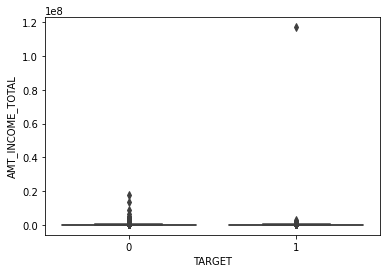

In [ ]:
sns.boxplot(data = df_app, y = 'AMT_INCOME_TOTAL', x = 'TARGET')

Looking at the above graph, there is an outlier in target 1. We need to investigate of what income type that affects this outlier and decide later what to do for this.

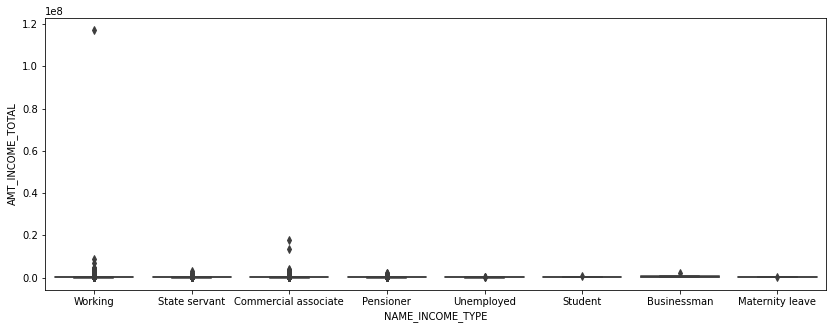

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(14,5))
sns.boxplot(data = df_app, y = 'AMT_INCOME_TOTAL', x = 'NAME_INCOME_TYPE')

In [ ]:
df_app.groupby('NAME_INCOME_TYPE')['AMT_INCOME_TOTAL'].agg('mean').sort_values(ascending = False)

NAME_INCOME_TYPE
Businessman             652500.000000
Commercial associate    202955.327289
State servant           179737.969506
Student                 170500.000000
Working                 163169.889223
Maternity leave         140400.000000
Pensioner               136401.292273
Unemployed              110536.363636
Name: AMT_INCOME_TOTAL, dtype: float64

Businessman income type has the largest amount of of total income. It is merely as much as 3 times more than commercial associate and approximately as much as 6 times more than Unemployed which makes sense, but this finding needs to be tested since the number of people who work as businessman is much fewer than those who are working. Furthermore, student can beat working people in this case it is rather irrational, since the number of student is very least, this findings becomes questionable

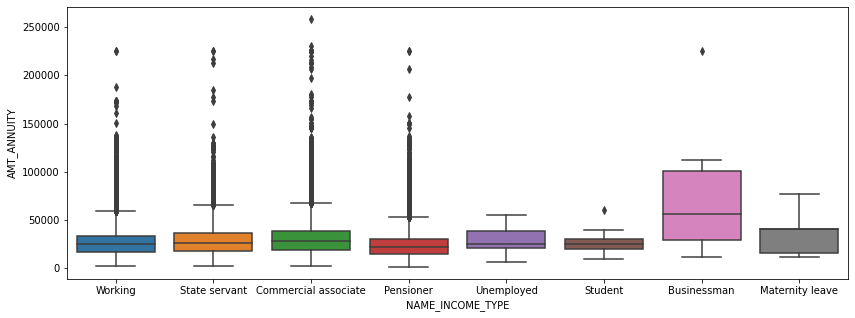

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(14,5))
sns.boxplot(data = df_app, y = 'AMT_ANNUITY', x = 'NAME_INCOME_TYPE')

In [ ]:
df_app.groupby('NAME_INCOME_TYPE')['AMT_ANNUITY'].agg('mean').sort_values(ascending = False)

NAME_INCOME_TYPE
Businessman             72675.000000
Maternity leave         36986.400000
Commercial associate    30415.221067
State servant           28864.490392
Unemployed              28178.386364
Working                 26492.651756
Student                 25188.000000
Pensioner               23900.400293
Name: AMT_ANNUITY, dtype: float64

The amount of annuity of businessman is still the highest. But, since the amount of these data is imbalanced, this finding becomes questionable

In [ ]:
px.histogram(df_app, color = 'TARGET', x = 'CNT_CHILDREN',  color_discrete_map = {0:'#6100F0', 1:'rgba(13, 222, 232, 1.6)'})

The number of children does not impact to the target, as we can see, target 1 and 0 people has highest count of value in 0 children, and the distribution is much alike between these 2 targets, in which we can say that number of children is not a good predictor

'DAYS_BIRTH','DAYS_EMPLOYED','DAYS_REGISTRATION', 'DAYS_ID_PUBLISH'

In [ ]:
px.histogram(df_app, color = 'TARGET', x = 'DAYS_BIRTH', color_discrete_map = {0:'#073000', 1:'rgba(200, 200, 10, 1.6)'})

In [ ]:
df_app[df_app['TARGET'] == 0]['DAYS_BIRTH'].median()

-15877.0

In [ ]:
df_app[df_app['TARGET'] == 1]['DAYS_BIRTH'].median()

-14282.0

The applicants who will likely to repay the loan is those who are younger than the applicants who will not likely to pay the loan

In [ ]:
px.histogram(df_app, color = 'TARGET', x = 'DAYS_EMPLOYED',color_discrete_map = {0:'#FFF000', 1:'rgba(10, 100, 100, 1.6)'})

In [ ]:
px.histogram(df_app, color = 'TARGET', x = 'DAYS_REGISTRATION',color_discrete_map = {0:'#0FF0FF', 1:'rgba(100, 30, 140, 1.6)'})

In [ ]:
px.histogram(df_app, color = 'TARGET', x = 'DAYS_ID_PUBLISH',color_discrete_map = {0:'#000DFF', 1:'rgba(0, 30, 140, 4)'})

We can assume that there are more than 50k outliers in data days_employed which are more than 350k days or 900 years of working. This is called anomaly, later on we should take action to mitigate this issue.

For days registration and days_id_publish, there is no significant evidences that target is strongly correlated with these features, since their distribution for target 0 and 1 is very much similar.

In [ ]:
px.histogram(df_app, color = 'TARGET', x = 'EXT_SOURCE_1',color_discrete_map = {0:'#000DFF', 1:'rgba(0, 30, 140, 4)'})

In [ ]:
px.histogram(df_app, color = 'TARGET', x = 'EXT_SOURCE_2',color_discrete_map = {0:'#000DFF', 1:'rgba(0, 30, 140, 4)'})

In [ ]:
px.histogram(df_app, color = 'TARGET', x = 'EXT_SOURCE_3',color_discrete_map = {0:'#000DFF', 1:'rgba(0, 30, 140, 4)'})

**FEATURE ENGINEERING and Data Cleaning**

In [ ]:
df_app['CODE_GENDER'].replace('XNA','F', inplace = True)
df_app_test['CODE_GENDER'].replace('XNA','F', inplace = True)

In [ ]:
df_app['CODE_GENDER'].unique()

array(['M', 'F'], dtype=object)

We replace XNA gender with the mode of the gender which is female

In [ ]:
count = 0
for col in df_app.columns:
  if df_app[col].isnull().sum()/len(df_app)*100 >= 30:
    df_app.drop(columns = col, inplace = True) 
    count += 1
print(count)
count = 0
for col in df_app_test.columns:
  if df_app_test[col].isnull().sum()/len(df_app_test)*100 >= 30:
    df_app_test.drop(columns = col, inplace = True) 
    count += 1
print(count)

We then can drop the variables whose missing values are more than 30%.
We choose 30% as a threshold since if the missing data is more than that, it does not carrey valid information

In [ ]:
# Create a label encoder object
le = LabelEncoder()
le_count = 0

# Iterate through the columns
for col in df_app:
    if df_app[col].dtype == 'object':
        # If 2 or fewer unique categories
        # Train on the training data
            le.fit(df_app[col])
            # Transform both training and testing data
            df_app[col] = le.transform(df_app[col])
            # df_app[col] = le.transform(df_app[col])
            
            # Keep track of how many columns were label encoded
            le_count += 1
            
print('%d columns were label encoded.' % le_count)

le_count = 0
for col in df_app_test:
    if df_app_test[col].dtype == 'object':
        # If 2 or fewer unique categories
        # Train on the training data
            le.fit(df_app_test[col])
            # Transform both training and testing data
            df_app_test[col] = le.transform(df_app_test[col])
            # df_app[col] = le.transform(df_app[col])
            
            # Keep track of how many columns were label encoded
            le_count += 1
            
print('%d columns were label encoded.' % le_count)

In [ ]:
def year(x):
      if x>0 and x<20 : 
        x = 0  
      elif x >= 20 and x<30 :
        x = 20 
      elif x>=30 and x<40 :
        x = 30
      elif x>=40 and x<50:
        x = 40
      elif x>=50 and x<60:
        x = 50
      else : 
        x = 60
      return x

In [ ]:
import numpy as np
df_app[['DAYS_BIRTH','DAYS_EMPLOYED','DAYS_REGISTRATION', 'DAYS_ID_PUBLISH']] = df_app[['DAYS_BIRTH','DAYS_EMPLOYED','DAYS_REGISTRATION', 'DAYS_ID_PUBLISH']].apply(lambda x: np.floor(x/-365))
df_app_test[['DAYS_BIRTH','DAYS_EMPLOYED','DAYS_REGISTRATION', 'DAYS_ID_PUBLISH']] = df_app_test[['DAYS_BIRTH','DAYS_EMPLOYED','DAYS_REGISTRATION', 'DAYS_ID_PUBLISH']].apply(lambda x: np.floor(x/-365))

Applying year instead of days by dividing each number by 365

In [ ]:
df_app.loc[(df_app.DAYS_EMPLOYED < -900),'DAYS_EMPLOYED']= np.nan
df_app_test.loc[(df_app.DAYS_EMPLOYED < -900),'DAYS_EMPLOYED']= np.nan

Replacing outlier with NaN value and imputing it with median

In [ ]:
df_app.fillna(df_app.quantile(0.5), inplace = True)
df_app_test.fillna(df_app.quantile(0.5), inplace = True)

In [ ]:
df_app[['DAYS_BIRTH','DAYS_REGISTRATION','DAYS_EMPLOYED', 'DAYS_ID_PUBLISH']].describe()

In [ ]:
df_app['contact_info'] = df_app['FLAG_MOBIL'] + df_app['FLAG_EMP_PHONE'] + df_app['FLAG_WORK_PHONE'] + df_app['FLAG_CONT_MOBILE'] + df_app['FLAG_PHONE'] + df_app['FLAG_EMAIL']
df_app.drop(columns = ['FLAG_MOBIL','FLAG_EMP_PHONE', 'FLAG_WORK_PHONE', 'FLAG_CONT_MOBILE' ,'FLAG_PHONE', 'FLAG_EMAIL'],axis = 1, inplace = True)
df_app_test['contact_info'] = df_app_test['FLAG_MOBIL'] + df_app_test['FLAG_EMP_PHONE'] + df_app_test['FLAG_WORK_PHONE'] + df_app_test['FLAG_CONT_MOBILE'] + df_app_test['FLAG_PHONE'] + df_app_test['FLAG_EMAIL']
df_app_test.drop(columns = ['FLAG_MOBIL','FLAG_EMP_PHONE', 'FLAG_WORK_PHONE', 'FLAG_CONT_MOBILE' ,'FLAG_PHONE', 'FLAG_EMAIL'],axis = 1, inplace = True)

sns.countplot(df_app['contact_info']);
plt.title('Count of ways to contact client');

In [ ]:
df_app['AMT_INCOME_TOTAL'] = np.log1p(df_app['AMT_INCOME_TOTAL'])
df_app['AMT_CREDIT'] = np.log1p(df_app['AMT_CREDIT'])
df_app['app AMT_CREDIT / AMT_ANNUITY'] = df_app['AMT_CREDIT'] / np.log1p(df_app['AMT_ANNUITY'])
df_app['app EXT_SOURCE mean'] = df_app[['EXT_SOURCE_2', 'EXT_SOURCE_3']].sum(axis = 1)
df_app['app AMT_INCOME_TOTAL / 12 - AMT_ANNUITY'] = df_app['AMT_INCOME_TOTAL'] / 12. - np.log1p(df_app['AMT_ANNUITY'])
df_app['app AMT_INCOME_TOTAL / AMT_ANNUITY'] = df_app['AMT_INCOME_TOTAL'] / np.log1p(df_app['AMT_ANNUITY'])
df_app['app AMT_INCOME_TOTAL - AMT_GOODS_PRICE'] = df_app['AMT_INCOME_TOTAL'] - np.log1p(df_app['AMT_GOODS_PRICE'])
df_app.drop(columns = ['AMT_INCOME_TOTAL','AMT_CREDIT','AMT_ANNUITY','EXT_SOURCE_2', 'EXT_SOURCE_3','AMT_GOODS_PRICE'], axis = 1, inplace = True)

In [ ]:
df_app_test['AMT_INCOME_TOTAL'] = np.log1p(df_app_test['AMT_INCOME_TOTAL'])
df_app_test['AMT_CREDIT'] = np.log1p(df_app_test['AMT_CREDIT'])
df_app_test['app AMT_CREDIT / AMT_ANNUITY'] = df_app_test['AMT_CREDIT'] / np.log1p(df_app_test['AMT_ANNUITY'])
df_app_test['app EXT_SOURCE mean'] = df_app_test[['EXT_SOURCE_2', 'EXT_SOURCE_3']].sum(axis = 1)
df_app_test['app AMT_INCOME_TOTAL / 12 - AMT_ANNUITY'] = df_app_test['AMT_INCOME_TOTAL'] / 12. - np.log1p(df_app_test['AMT_ANNUITY'])
df_app_test['app AMT_INCOME_TOTAL / AMT_ANNUITY'] = df_app_test['AMT_INCOME_TOTAL'] / np.log1p(df_app_test['AMT_ANNUITY'])
df_app_test['app AMT_INCOME_TOTAL - AMT_GOODS_PRICE'] = df_app_test['AMT_INCOME_TOTAL'] - np.log1p(df_app_test['AMT_GOODS_PRICE'])
df_app_test.drop(columns = ['AMT_INCOME_TOTAL','AMT_CREDIT','AMT_ANNUITY','EXT_SOURCE_2', 'EXT_SOURCE_3','AMT_GOODS_PRICE'], axis = 1, inplace = True)

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score, cross_val_predict
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.model_selection import train_test_split

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(df_app.drop(['TARGET'],axis=1),df_app['TARGET'],test_size=0.15,random_state=125421)
test = df_app_test

In [ ]:
len(df_app.columns)

In [ ]:
from imblearn.over_sampling import SMOTE
oversample = SMOTE()
X_r, y_r = oversample.fit_resample(X_train, y_train)
# X_r, y_r = X_train, y_train

In [ ]:
from sklearn.preprocessing import RobustScaler

sc = RobustScaler()
X_sc = sc.fit_transform(X_r)
X_val_sc=sc.transform(X_test)
test_sc = sc.transform(test)
y_sc = y_r
y_val_sc = y_test

In [ ]:
import lightgbm as lgb
params = {
    'boosting': 'dart',
    'application': 'binary',
    'learning_rate': 0.05,
    'num_leaves': 30,
    'max_depth': 5,
    'feature_fraction': 0.9,
    'scale_pos_weight': 2,
    'reg_alpha': 0.05,
    'reg_lambda': 0.1}
model = lgb.train(params, lgb.Dataset(X_sc, y_sc), 1000, [lgb.Dataset(X_sc, y_sc), lgb.Dataset(X_val_sc, y_val_sc)], verbose_eval=10)

[10]	valid_0's binary_logloss: 0.58549	valid_1's binary_logloss: 0.656906
[20]	valid_0's binary_logloss: 0.514157	valid_1's binary_logloss: 0.623545
[30]	valid_0's binary_logloss: 0.470396	valid_1's binary_logloss: 0.597211
[40]	valid_0's binary_logloss: 0.441654	valid_1's binary_logloss: 0.573575
[50]	valid_0's binary_logloss: 0.434451	valid_1's binary_logloss: 0.563689
[60]	valid_0's binary_logloss: 0.419764	valid_1's binary_logloss: 0.55113
[70]	valid_0's binary_logloss: 0.408267	valid_1's binary_logloss: 0.540528
[80]	valid_0's binary_logloss: 0.394043	valid_1's binary_logloss: 0.527858
[90]	valid_0's binary_logloss: 0.39571	valid_1's binary_logloss: 0.526859
[100]	valid_0's binary_logloss: 0.387207	valid_1's binary_logloss: 0.520341
[110]	valid_0's binary_logloss: 0.395797	valid_1's binary_logloss: 0.525712
[120]	valid_0's binary_logloss: 0.374936	valid_1's binary_logloss: 0.509084
[130]	valid_0's binary_logloss: 0.365726	valid_1's binary_logloss: 0.500681
[140]	valid_0's binary_l

In [ ]:
from sklearn.linear_model import LogisticRegression

log_reg = LogisticRegression(solver = 'liblinear', penalty = 'l1', C = 0.1
                             )
log_reg.fit(X_sc, y_sc)
print("Classification Report: \n {}\n".format(classification_report(y_val_sc, log_reg.predict(X_val_sc))))

Classification Report: 
               precision    recall  f1-score   support

           0       0.93      0.85      0.89     42384
           1       0.15      0.29      0.19      3743

    accuracy                           0.81     46127
   macro avg       0.54      0.57      0.54     46127
weighted avg       0.87      0.81      0.83     46127




In [ ]:
from sklearn.metrics import roc_auc_score
from sklearn import metrics
roc_auc_score(y_val_sc,log_reg.predict(X_val_sc))

In [ ]:
y_pred_proba = log_reg.predict_proba(X_val_sc)[::,1]
y_pred_proba_clr = clf_rf.predict_proba(X_val_sc)[::,1]
fpr, tpr, _ = metrics.roc_curve(y_val_sc,  y_pred_proba)
fpr_rf, tpr_rf, _ = metrics.roc_curve(y_val_sc,  y_pred_proba_clr)
fpr_lgb, tpr_lgb, _ = metrics.roc_curve(y_val_sc, a)
#create ROC curve
plt.plot(fpr,tpr)
plt.plot(fpr_rf,tpr_rf)
plt.plot(fpr_lgb,tpr_lgb)
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [ ]:
print("Classification Report: \n {}\n".format(classification_report(y_val_sc,a)))

In [ ]:
predicted = model.predict(X_val_sc)
a = []
for i in predicted:
  if i < 0.5:
    c = 0
  else:
    c = 1
  a.append(c)


In [ ]:
predicted = model.predict(test_sc)

In [ ]:
submit = test[['SK_ID_CURR']]
submit['TARGET'] = predictions

# Save the submission dataframe to a csv file
submit.to_csv('logreg_baseline_engineered.csv', index = False)

In [ ]:
submit = test[['SK_ID_CURR']]
submit['TARGET'] = predicted

# Save the submission dataframe to a csv file
submit.to_csv('LGB_2.csv', index = False)

In [ ]:
# log_reg_pred = log_reg.predict_proba(X_val_sc)[:, 1]

In [ ]:
# log_reg_pred

In [ ]:
clf_rf = RandomForestClassifier(n_estimators=100, random_state=213421)
clf_rf.fit(X_sc, y_sc)
print("Classification Report: \n {}\n".format(classification_report(y_val_sc, clf_rf.predict(X_val_sc))))

In [ ]:
feature_names = [i for i in (df_app.columns.drop('TARGET'))]

importances = clf_rf.feature_importances_
std = np.std([tree.feature_importances_ for tree in clf_rf.estimators_], axis=0)
forest_importances = pd.Series(importances, index=feature_names)
fig, ax = plt.subplots()
forest_importances.plot.bar(yerr=std, ax=ax)
ax.set_title("Feature importances using MDI")
ax.set_ylabel("Mean decrease in impurity")
fig.tight_layout()

In [ ]:
forest_importances.sort_values(ascending = False)[0:10]

In [ ]:
estimator = clf_rf.estimators_[5]

In [ ]:
from sklearn.tree import export_graphviz
# Export as dot file
export_graphviz(estimator, out_file='tree.dot', 
                feature_names = df_app.drop(columns = 'TARGET').columns,
                class_names = 'TARGET',
                rounded = True, proportion = False, 
                precision = 2, filled = True)
from subprocess import call
call(['dot','tree.dot', '-o', 'tree.png', '-Gdpi=400'])

# Display in jupyter notebook
from IPython.display import Image
Image(filename = 'tree.png')

In [ ]:
roc_auc_score(y_val_sc,a)

In [ ]:
predictions = clf_rf.predict_proba(test_sc)[:,1]

In [ ]:
submit = test[['SK_ID_CURR']]
submit['TARGET'] = predictions

# Save the submission dataframe to a csv file
submit.to_csv('random_forest_baseline_engineered.csv', index = False)

In [ ]:
submit